<a href="https://colab.research.google.com/github/kojomensahonums/GSOC24_ML4SCI/blob/master/Image_classification_with_no_labels_Roboflow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In this notebook, simulation of image classification without labels is performed using Autodistill and YOLOv8. Images with corresponding labels in the csv file provided are moved into a separate folder. Image classification model is trained on images without labels and the trained model is later used to predict on the labelled images to allow for accurate model evaluation.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
%%capture
!pip install autodistill autodistill-clip autodistill-yolov8 supervision roboflow
!pip install -U ultralytics

In [5]:

from autodistill_clip import CLIP
from autodistill.detection import CaptionOntology
from autodistill_yolov8 import YOLOv8
import supervision as sv
import roboflow
import cv2
import os
from PIL import Image
import pandas as pd


### Accessing Image directories<br>
Two directories, one containing images with labels and another directory, one with images without labels have been created.

In [6]:
# Directory containing images
image_dir = "/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/Hard_Band2/Band2"  # Update with your image directory path

# Load image filenames
image_filenames = os.listdir(image_dir)

# Load IDs from CSV file
csv_file = "/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/Hard_Band2/hard_Band2.csv"
df = pd.read_csv(csv_file)
csv_ids = set(df["ID"])

# Filter image filenames based on whether they have corresponding IDs in the CSV file
labeled_images = [filename for filename in os.listdir(image_dir) if filename.split('/')[-1] in csv_ids]
unlabeled_images = [filename for filename in os.listdir(image_dir) if filename.split('/')[-1] not in csv_ids]

# Now you have two lists: labeled_images and unlabeled_images
# You can use these lists to load the corresponding images as needed


### Image Visualisation

100%|████████████████████████████████████████| 338M/338M [00:02<00:00, 160MiB/s]


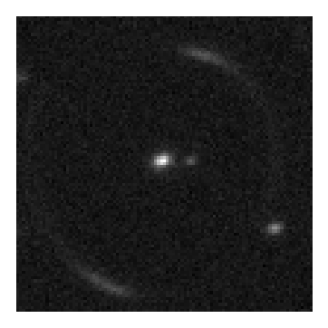

lens


In [10]:
base_model = CLIP(ontology=CaptionOntology({"lens": "lens", "no lens": "no lens"}))

image = "/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_unlabeled_images/imageSDSS_I-192434.png"
pred = base_model.predict(image)

sv.plot_image(cv2.imread(image), size=(4, 4))

classes = base_model.ontology.classes()
print(classes[pred.class_id[0]])

### Custom Label images in unlabelled directory using Unsupervised techniques

In [13]:
base_model.label(input_folder="/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_unlabeled_images", output_folder="/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset", extension=".png")


Labeling /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_unlabeled_images/imageSDSS_I-195416.png: 100%|██████████| 10400/10400 [14:09<00:00, 12.24it/s]


Labeled dataset created - ready for distillation.


ClassificationDataset(classes=['lens', 'no lens'], images={'imageSDSS_I-161530.png': array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
  

### Model Training

In [14]:
from ultralytics import YOLO
target_model = YOLO('yolov8n-cls.pt')

target_model.train(data="/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset", epochs=100)

100%|██████████| 5.30M/5.30M [00:00<00:00, 163MB/s]

Ultralytics YOLOv8.1.42 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


engine/trainer: task=classify, mode=train, model=yolov8n-cls.pt, data=/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset, epochs=100, time=None, patience=100, batch=16, imgsz=224, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, fo

100%|██████████| 6.23M/6.23M [00:00<00:00, 266MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset/train... 7279 images, 0 corrupt: 100%|██████████| 7279/7279 [01:28<00:00, 82.10it/s] 


train: New cache created: /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset/train.cache


val: Scanning /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset/test... 1560 images, 0 corrupt: 100%|██████████| 1560/1560 [00:14<00:00, 110.67it/s]


val: New cache created: /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset/test.cache
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 26 weight(decay=0.0), 27 weight(decay=0.0005), 27 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 224 train, 224 val
Using 8 dataloader workers
Logging results to runs/classify/train
Starting training for 100 epochs...

      Epoch    GPU_mem       loss  Instances       Size


      1/100     0.763G     0.3142         16        224:   9%|▉         | 41/455 [00:03<00:27, 15.18it/s]

      1/100     0.763G     0.2328         16        224:  16%|█▌        | 71/455 [00:05<00:29, 13.02it/s]
100%|██████████| 755k/755k [00:00<00:00, 62.9MB/s]
      1/100     0.765G     0.1412         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.83it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.49it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



      2/100     0.765G     0.1175         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.04it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.38it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



      3/100     0.744G     0.1225         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.39it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.43it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



      4/100     0.744G     0.1283         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.17it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.85it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



      5/100     0.744G     0.1105         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.33it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.61it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



      6/100     0.744G     0.1139         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.17it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.59it/s]

                   all      0.957          1

      Epoch    GPU_mem       loss  Instances       Size



      7/100     0.744G     0.1085         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.06it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.16it/s]

                   all      0.969          1

      Epoch    GPU_mem       loss  Instances       Size



      8/100     0.747G      0.104         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.04it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.99it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



      9/100     0.744G    0.09607         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.13it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.79it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     10/100     0.744G     0.1037         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.22it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.70it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     11/100     0.744G    0.09954         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.99it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.65it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     12/100     0.744G    0.09444         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.16it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.10it/s]

                   all      0.968          1

      Epoch    GPU_mem       loss  Instances       Size



     13/100     0.744G    0.09606         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.20it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.29it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     14/100     0.744G    0.09915         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.17it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.62it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     15/100     0.744G    0.09311         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.02it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.73it/s]

                   all      0.968          1

      Epoch    GPU_mem       loss  Instances       Size



     16/100     0.744G    0.09145         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.19it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.44it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     17/100     0.744G    0.09036         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.98it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.80it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     18/100     0.744G    0.09226         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.95it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.83it/s]

                   all      0.969          1

      Epoch    GPU_mem       loss  Instances       Size



     19/100     0.744G    0.09164         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.96it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.95it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     20/100     0.744G    0.08855         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.05it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.68it/s]

                   all       0.97          1

      Epoch    GPU_mem       loss  Instances       Size



     21/100     0.744G    0.08737         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.86it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.64it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     22/100     0.744G    0.09173         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.06it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.29it/s]

                   all       0.97          1

      Epoch    GPU_mem       loss  Instances       Size



     23/100     0.744G    0.08784         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.60it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.28it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     24/100     0.744G     0.0849         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.84it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.36it/s]

                   all       0.97          1

      Epoch    GPU_mem       loss  Instances       Size



     25/100     0.744G    0.08953         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.89it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.25it/s]

                   all      0.967          1

      Epoch    GPU_mem       loss  Instances       Size



     26/100     0.744G    0.08606         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.88it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.41it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     27/100     0.744G    0.08165         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.89it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.12it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     28/100     0.744G     0.0885         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.67it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.38it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     29/100     0.744G    0.08469         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.78it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.61it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     30/100     0.744G     0.0844         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.73it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.61it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     31/100     0.744G    0.08574         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.57it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.74it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     32/100     0.747G    0.08338         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.73it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.61it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     33/100     0.747G    0.08138         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.75it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.82it/s]

                   all      0.973          1

      Epoch    GPU_mem       loss  Instances       Size



     34/100     0.744G    0.08056         15        224: 100%|██████████| 455/455 [00:33<00:00, 13.59it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.88it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     35/100     0.744G    0.07807         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.88it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.78it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     36/100     0.744G    0.08191         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.85it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.58it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     37/100     0.747G    0.08288         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.02it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.61it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     38/100     0.744G    0.08288         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.14it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.35it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     39/100     0.744G    0.07553         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.03it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.18it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     40/100     0.747G    0.07927         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.12it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.47it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     41/100     0.744G    0.07745         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.10it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.54it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     42/100     0.744G    0.08177         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.98it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.71it/s]

                   all       0.97          1

      Epoch    GPU_mem       loss  Instances       Size



     43/100     0.744G    0.07862         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.96it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.68it/s]

                   all      0.969          1

      Epoch    GPU_mem       loss  Instances       Size



     44/100     0.744G    0.08032         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.94it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.88it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     45/100     0.747G    0.07636         15        224: 100%|██████████| 455/455 [00:32<00:00, 13.91it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.04it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     46/100     0.744G    0.08073         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.06it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.80it/s]

                   all       0.97          1

      Epoch    GPU_mem       loss  Instances       Size



     47/100     0.744G    0.07532         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.06it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.61it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     48/100     0.747G    0.07353         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.00it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.15it/s]

                   all      0.973          1

      Epoch    GPU_mem       loss  Instances       Size



     49/100     0.744G    0.07844         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.12it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.40it/s]

                   all      0.969          1

      Epoch    GPU_mem       loss  Instances       Size



     50/100     0.744G    0.07286         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.29it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.34it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     51/100     0.744G    0.07557         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.23it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.52it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     52/100     0.744G    0.07348         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.25it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.77it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     53/100     0.744G     0.0756         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.08it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.67it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     54/100     0.744G    0.07178         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.20it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.95it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     55/100     0.744G    0.07082         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.14it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.69it/s]

                   all      0.968          1

      Epoch    GPU_mem       loss  Instances       Size



     56/100     0.744G     0.0742         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.12it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.78it/s]

                   all      0.973          1

      Epoch    GPU_mem       loss  Instances       Size



     57/100     0.744G    0.06903         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.11it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.50it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     58/100     0.747G    0.07415         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.35it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.86it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     59/100     0.744G    0.06768         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.37it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.55it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     60/100     0.744G    0.07315         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.35it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.05it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     61/100     0.744G    0.06734         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.18it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.57it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     62/100     0.744G    0.07343         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.06it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.91it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     63/100     0.744G    0.06922         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.33it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.46it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     64/100     0.744G    0.07363         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.32it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.48it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     65/100     0.747G    0.07019         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.50it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.70it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     66/100     0.747G    0.06853         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.41it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.84it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     67/100     0.744G    0.06667         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.51it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.13it/s]

                   all       0.97          1

      Epoch    GPU_mem       loss  Instances       Size



     68/100     0.744G    0.06864         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.40it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.01it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     69/100     0.744G    0.06556         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.32it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.29it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     70/100     0.744G    0.06719         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.40it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  8.51it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     71/100     0.744G    0.06474         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.60it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.63it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     72/100     0.744G    0.06755         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.59it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.69it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     73/100     0.744G    0.06795         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.44it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.75it/s]

                   all       0.97          1

      Epoch    GPU_mem       loss  Instances       Size



     74/100     0.744G     0.0612         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.58it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.35it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     75/100     0.744G    0.06558         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.41it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.03it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     76/100     0.744G    0.06057         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.66it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.74it/s]

                   all      0.969          1

      Epoch    GPU_mem       loss  Instances       Size



     77/100     0.744G    0.06306         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.62it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.45it/s]

                   all      0.969          1

      Epoch    GPU_mem       loss  Instances       Size



     78/100     0.744G    0.06192         15        224: 100%|██████████| 455/455 [00:30<00:00, 14.72it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.86it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     79/100     0.744G    0.06363         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.56it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.32it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     80/100     0.747G    0.06451         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.54it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.28it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     81/100     0.744G    0.06215         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.28it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.90it/s]

                   all      0.969          1

      Epoch    GPU_mem       loss  Instances       Size



     82/100     0.744G    0.06442         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.56it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.87it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     83/100     0.744G    0.06189         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.59it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.53it/s]

                   all      0.974          1

      Epoch    GPU_mem       loss  Instances       Size



     84/100     0.747G    0.06302         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.55it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.60it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     85/100     0.744G     0.0579         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.63it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.98it/s]

                   all      0.975          1

      Epoch    GPU_mem       loss  Instances       Size



     86/100     0.747G    0.05866         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.36it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.93it/s]

                   all      0.973          1

      Epoch    GPU_mem       loss  Instances       Size



     87/100     0.744G    0.05894         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.51it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.98it/s]

                   all      0.973          1

      Epoch    GPU_mem       loss  Instances       Size



     88/100     0.744G    0.06028         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.48it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.21it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     89/100     0.744G    0.05721         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.57it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.96it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     90/100     0.747G    0.05523         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.52it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.88it/s]

                   all      0.971          1



      Epoch    GPU_mem       loss  Instances       Size


     91/100     0.744G    0.05512         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.41it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.58it/s]

                   all      0.973          1

      Epoch    GPU_mem       loss  Instances       Size



     92/100     0.744G    0.05566         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.53it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.87it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     93/100     0.744G    0.05055         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.45it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.99it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     94/100     0.744G     0.0531         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.30it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.88it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     95/100     0.744G    0.05835         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.21it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.72it/s]

                   all      0.971          1

      Epoch    GPU_mem       loss  Instances       Size



     96/100     0.744G    0.05761         15        224: 100%|██████████| 455/455 [00:32<00:00, 14.12it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.89it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     97/100     0.744G    0.05842         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.34it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00,  9.84it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     98/100     0.744G    0.05591         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.40it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.47it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



     99/100     0.744G    0.05263         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.47it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:05<00:00,  9.76it/s]

                   all      0.972          1

      Epoch    GPU_mem       loss  Instances       Size



    100/100     0.744G    0.05261         15        224: 100%|██████████| 455/455 [00:31<00:00, 14.60it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.06it/s]

                   all      0.972          1

100 epochs completed in 1.036 hours.
Optimizer stripped from runs/classify/train/weights/last.pt, 3.0MB


Optimizer stripped from runs/classify/train/weights/best.pt, 3.0MB

Validating runs/classify/train/weights/best.pt...
Ultralytics YOLOv8.1.42 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n-cls summary (fused): 73 layers, 1437442 parameters, 0 gradients, 3.3 GFLOPs
WARNING ⚠️ Dataset 'split=val' not found, using 'split=test' instead.
train: /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset/train... found 7279 images in 2 classes ✅ 
val: None...
test: /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dataset/test... found 1560 images in 2 classes ✅ 


               classes   top1_acc   top5_acc: 100%|██████████| 49/49 [00:04<00:00, 10.68it/s]


                   all      0.975          1
Speed: 0.1ms preprocess, 0.5ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to runs/classify/train
Results saved to runs/classify/train


ultralytics.utils.metrics.ClassifyMetrics object with attributes:

confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c19e9fff130>
curves: []
curves_results: []
fitness: 0.987500011920929
keys: ['metrics/accuracy_top1', 'metrics/accuracy_top5']
results_dict: {'metrics/accuracy_top1': 0.9750000238418579, 'metrics/accuracy_top5': 1.0, 'fitness': 0.987500011920929}
save_dir: PosixPath('runs/classify/train')
speed: {'preprocess': 0.10262315089886005, 'inference': 0.5128304163614908, 'loss': 0.0005454589159060747, 'postprocess': 0.00046231807806552987}
task: 'classify'
top1: 0.9750000238418579
top5: 1.0

### Model Performance Evaluation

Confusion matrix

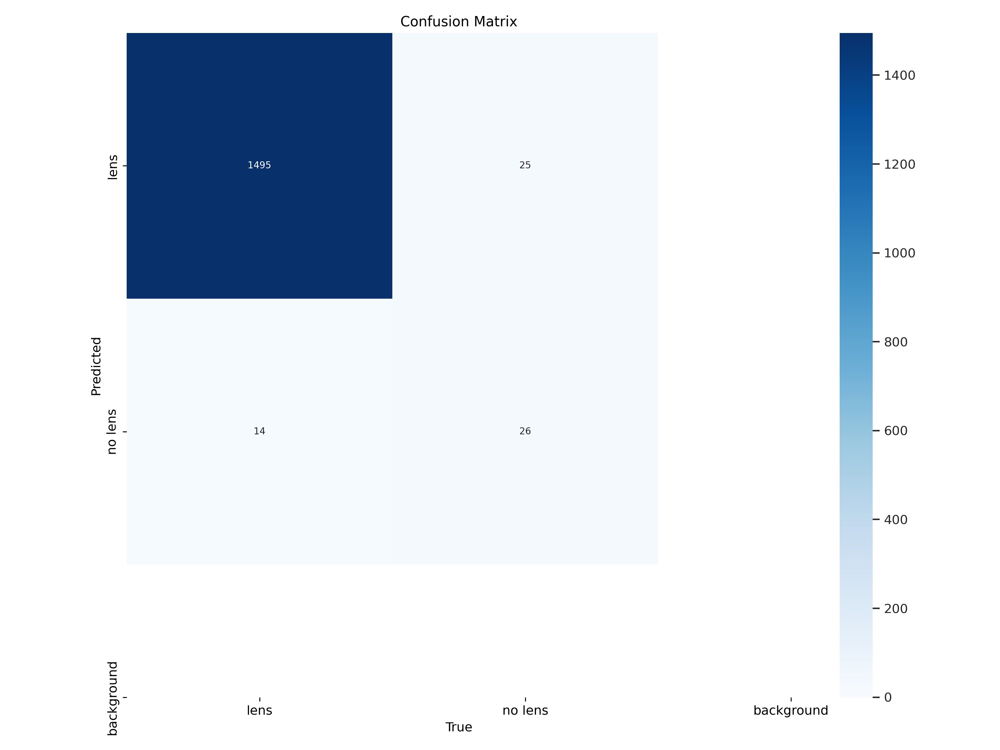

In [21]:
from IPython.display import Image

Image(filename='/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/runs/classify/train/confusion_matrix.png', width=600)

Loss vs Accuracy

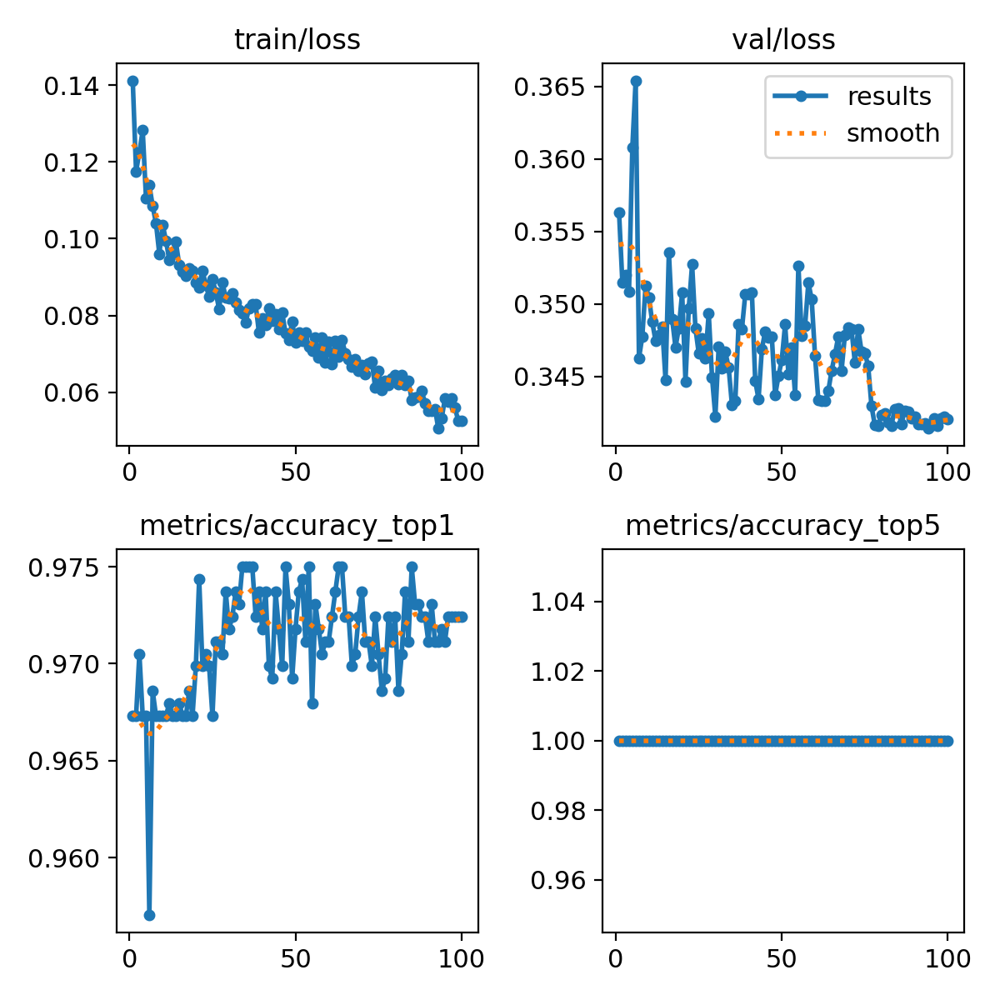

In [22]:
from IPython.display import Image

Image(filename='/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/runs/classify/train/results.png', width=600)

### Model Predictions

In [23]:
pred = target_model.predict("/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images/imageSDSS_I-100006.png")#, confidence=0.5)
print(pred[0].names)
print(pred[0].probs)


image 1/1 /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images/imageSDSS_I-100006.png: 224x224 lens 1.00, no lens 0.00, 6.1ms
Speed: 6.0ms preprocess, 6.1ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)
{0: 'lens', 1: 'no lens'}
ultralytics.engine.results.Probs object with attributes:

data: tensor([9.9997e-01, 3.1779e-05], device='cuda:0')
orig_shape: None
shape: torch.Size([2])
top1: 0
top1conf: tensor(1.0000, device='cuda:0')
top5: [0, 1]
top5conf: tensor([9.9997e-01, 3.1779e-05], device='cuda:0')


In [41]:
from IPython.display import Image
import random

Image(filename='/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/runs/classify/train/confusion_matrix.png', width=600)

random_image = random.choice(os.listdir("/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images"))

results = target_model.predict(os.path.join("/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images", random_image))

print(results[0].names)
print(results[0].probs.data)



image 1/1 /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images/imageSDSS_I-103630.png: 224x224 lens 0.98, no lens 0.02, 4.0ms
Speed: 3.6ms preprocess, 4.0ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)
{0: 'lens', 1: 'no lens'}
tensor([0.9830, 0.0170], device='cuda:0')


Predict on all images in the labelled set and store results as csv

In [43]:
list_evaluate = []
prob_evaluate = []
image_name = []
try:
  for image in os.listdir("/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images"):
    results = target_model.predict(os.path.join("/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images", image))
    image_name.append(image)
    list_evaluate.append(results[0].names)
    prob_evaluate.append(results[0].probs)
except IndexError:
  print("Unknown error, skip!")
else:
  results_df = pd.DataFrame({"names": image_name, "score": list_evaluate, "tensor": prob_evaluate})
  results_df.to_csv("/content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/results_evaluate.csv", index=False)




Streaming output truncated to the last 5000 lines.
image 1/1 /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images/imageSDSS_I-107575.png: 224x224 lens 1.00, no lens 0.00, 3.8ms
Speed: 3.3ms preprocess, 3.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)

image 1/1 /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images/imageSDSS_I-106947.png: 224x224 lens 0.60, no lens 0.40, 3.7ms
Speed: 3.2ms preprocess, 3.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)

image 1/1 /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images/imageSDSS_I-106938.png: 224x224 lens 1.00, no lens 0.00, 3.7ms
Speed: 3.0ms preprocess, 3.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)

image 1/1 /content/drive/Othercomputers/My laptop/GSOC_24/ML4SCI/Lens_Finding/dir_labeled_images/imageSDSS_I-106738.png: 224x224 lens 0.81, no lens 0.19, 3.7ms
Speed: 3.2ms prepr